<a href="https://colab.research.google.com/github/microsoft/qlib/blob/main/examples/workflow_by_code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#  Copyright (c) Microsoft Corporation.
#  Licensed under the MIT License.

In [2]:
import sys, site
from pathlib import Path

################################# NOTE #################################
#  Please be aware that if colab installs the latest numpy and pyqlib  #
#  in this cell, users should RESTART the runtime in order to run the  #
#  following cells successfully.                                       #
########################################################################

try:
    import qlib
except ImportError:
    # install qlib
    ! pip install --upgrade numpy
    ! pip install pyqlib
    if "google.colab" in sys.modules:
        # The Google colab environment is a little outdated. We have to downgrade the pyyaml to make it compatible with other packages
        ! pip install pyyaml==5.4.1
    # reload
    site.main()

scripts_dir = Path.cwd().parent.joinpath("scripts")
if not scripts_dir.joinpath("get_data.py").exists():
    # download get_data.py script
    scripts_dir = Path("~/tmp/qlib_code/scripts").expanduser().resolve()
    scripts_dir.mkdir(parents=True, exist_ok=True)
    import requests

    with requests.get("https://raw.githubusercontent.com/microsoft/qlib/main/scripts/get_data.py", timeout=10) as resp:
        with open(scripts_dir.joinpath("get_data.py"), "wb") as fp:
            fp.write(resp.content)

In [3]:
import qlib
import pandas as pd
from qlib.constant import REG_CN
from qlib.utils import exists_qlib_data, init_instance_by_config
from qlib.workflow import R
from qlib.workflow.record_temp import SignalRecord, PortAnaRecord
from qlib.utils import flatten_dict

Gym has been unmaintained since 2022 and does not support NumPy 2.0 amongst other critical functionality.
Please upgrade to Gymnasium, the maintained drop-in replacement of Gym, or contact the authors of your software and request that they upgrade.
Users of this version of Gym should be able to simply replace 'import gym' with 'import gymnasium as gym' in the vast majority of cases.
See the migration guide at https://gymnasium.farama.org/introduction/migration_guide/ for additional information.


In [4]:
# use default data
# NOTE: need to download data from remote: python scripts/get_data.py qlib_data_cn --target_dir ~/.qlib/qlib_data/cn_data
provider_uri = "~/.qlib/qlib_data/cn_data"  # target_dir
if not exists_qlib_data(provider_uri):
    print(f"Qlib data is not found in {provider_uri}")
    sys.path.append(str(scripts_dir))
    from get_data import GetData

    GetData().qlib_data(target_dir=provider_uri, region=REG_CN)
qlib.init(provider_uri=provider_uri, region=REG_CN)

[85941:MainThread](2025-08-28 11:56:38,700) INFO - qlib.Initialization - [config.py:452] - default_conf: client.
[85941:MainThread](2025-08-28 11:56:38,702) INFO - qlib.Initialization - [__init__.py:79] - qlib successfully initialized based on client settings.
[85941:MainThread](2025-08-28 11:56:38,702) INFO - qlib.Initialization - [__init__.py:81] - data_path={'__DEFAULT_FREQ': PosixPath('/Users/huhao/.qlib/qlib_data/cn_data')}


In [5]:
market = "csi300"
benchmark = "SH000300"

market = "csi300"
👉 我研究的股票范围是 沪深300成分股。

benchmark = "SH000300"
👉 我的策略绩效对比基准是 沪深300指数本身。

# train model

In [14]:
###################################
# train model
###################################
data_handler_config = {
    "start_time": "2008-01-01",
    "end_time": "2020-08-01",
    "fit_start_time": "2008-01-01",
    "fit_end_time": "2014-12-31",
    "instruments": market,
}


这段配置定义了数据范围和训练集划分：

整体研究数据：2008-01-01 → 2020-08-01

训练集 (fit)：2008-01-01 → 2014-12-31

股票池：沪深300 (csi300)

后续通常会再划分验证集 (validation) 和测试集 (test)，比如：

训练集：2008–2014

验证集：2015–2017

测试集：2018–2020

In [16]:
task = {
    "model": {
        "class": "LGBModel",
        "module_path": "qlib.contrib.model.gbdt",
        "kwargs": {
            "loss": "mse",
            "colsample_bytree": 0.8879,
            "learning_rate": 0.0421,
            "subsample": 0.8789,
            "lambda_l1": 205.6999,
            "lambda_l2": 580.9768,
            "max_depth": 8,
            "num_leaves": 210,
            "num_threads": 20,
        },
    },
    "dataset": {
        "class": "DatasetH",
        "module_path": "qlib.data.dataset",
        "kwargs": {
            "handler": {
                "class": "Alpha158",
                "module_path": "qlib.contrib.data.handler",
                "kwargs": data_handler_config,
            },
            "segments": {
                "train": ("2008-01-01", "2014-12-31"),
                "valid": ("2015-01-01", "2016-12-31"),
                "test": ("2017-01-01", "2020-08-01"),
            },
        },
    },
}

解释 model

### 🔹 最外层 `"model"`

说明这是一个 **模型配置块**。

---

### 1. `"class": "LGBModel"`

* 使用的模型类名是 `LGBModel`。
* 这是 Qlib 提供的一个 **LightGBM 封装模型**，基于梯度提升决策树（GBDT）。

---

### 2. `"module_path": "qlib.contrib.model.gbdt"`

* 模型所在的 Python 模块路径。
* 表明 `LGBModel` 定义在 `qlib.contrib.model.gbdt` 里。
* Qlib 会动态 import 这个模块来加载模型。

---

### 3. `"kwargs": { ... }`

* **模型的超参数 (hyperparameters)**，会传给 LightGBM。
* 逐个解释：

| 参数                           | 含义                                               |
| ---------------------------- | ------------------------------------------------ |
| `"loss": "mse"`              | 损失函数：均方误差 (mean squared error)，适合回归任务（比如预测股票收益）。 |
| `"colsample_bytree": 0.8879` | 每棵树训练时随机选择约 88.79% 的特征，用于降低过拟合。                  |
| `"learning_rate": 0.0421`    | 学习率，控制每棵树对结果的贡献，值小训练更慢但更稳健。                      |
| `"subsample": 0.8789`        | 训练时随机采样约 87.89% 的样本，防止过拟合。                       |
| `"lambda_l1": 205.6999`      | L1 正则化系数（稀疏化权重，提升泛化能力）。                          |
| `"lambda_l2": 580.9768`      | L2 正则化系数（限制模型复杂度，防止过拟合）。                         |
| `"max_depth": 8`             | 树的最大深度，控制模型复杂度。                                  |
| `"num_leaves": 210`          | 单棵树的最大叶子节点数，影响拟合能力。                              |
| `"num_threads": 20`          | 训练时使用的 CPU 线程数，加快训练速度。                           |

---




解释 dataset 配置

### 🔹 最外层 `"dataset"`

说明这是一个 **数据集配置块**。

---

### 1. `"class": "DatasetH"`

* 使用的类是 `DatasetH`，位于 `qlib.data.dataset` 模块。
* `DatasetH` 是 Qlib 提供的一个 **标准化数据集封装类**，会把 handler（特征工程器）处理的数据按时间切片成 `train/valid/test`。

---

### 2. `"kwargs": { ... }`

`DatasetH` 的初始化参数。

---

#### (a) `"handler": {...}`

* 定义数据处理器 (handler)，用于生成特征和标签。

```python
"handler": {
    "class": "Alpha158",
    "module_path": "qlib.contrib.data.handler",
    "kwargs": data_handler_config,
}
```

* **`class = "Alpha158"`**
  使用的是 **Alpha158 因子集**，这是 Qlib 内置的 158 个经典量化因子（技术指标、财务特征等），适合做股票预测。

* **`module_path = "qlib.contrib.data.handler"`**
  表明 `Alpha158` 定义在 `qlib.contrib.data.handler` 里。

* **`kwargs = data_handler_config`**
  传入前面你定义的 `data_handler_config`（包含起止时间、股票池等）。

👉 总结：`handler` 决定了“我用什么因子特征 + 数据范围”。

---

#### (b) `"segments": {...}`

* 定义数据集的时间切分，用于训练、验证、测试。

```python
"segments": {
    "train": ("2008-01-01", "2014-12-31"),
    "valid": ("2015-01-01", "2016-12-31"),
    "test": ("2017-01-01", "2020-08-01"),
}
```

* **训练集 (train)**：2008-01-01 → 2014-12-31
* **验证集 (valid)**：2015-01-01 → 2016-12-31
* **测试集 (test)**：2017-01-01 → 2020-08-01

👉 这是典型的 **时间序列切分**，保证验证/测试的数据严格在训练之后，防止数据泄漏。


In [6]:
# model initialization
model = init_instance_by_config(task["model"])
dataset = init_instance_by_config(task["dataset"])

# start exp to train model
with R.start(experiment_name="train_model"):
    R.log_params(**flatten_dict(task))
    model.fit(dataset)
    R.save_objects(trained_model=model)
    rid = R.get_recorder().id

ModuleNotFoundError. CatBoostModel are skipped. (optional: maybe installing CatBoostModel can fix it.)
ModuleNotFoundError. XGBModel is skipped(optional: maybe installing xgboost can fix it).
ModuleNotFoundError.  PyTorch models are skipped (optional: maybe installing pytorch can fix it).


[85941:MainThread](2025-08-28 11:57:00,001) INFO - qlib.timer - [log.py:127] - Time cost: 17.215s | Loading data Done
[85941:MainThread](2025-08-28 11:57:00,247) INFO - qlib.timer - [log.py:127] - Time cost: 0.098s | DropnaLabel Done
[85941:MainThread](2025-08-28 11:57:01,018) INFO - qlib.timer - [log.py:127] - Time cost: 0.771s | CSZScoreNorm Done
[85941:MainThread](2025-08-28 11:57:01,025) INFO - qlib.timer - [log.py:127] - Time cost: 1.023s | fit & process data Done
[85941:MainThread](2025-08-28 11:57:01,025) INFO - qlib.timer - [log.py:127] - Time cost: 18.240s | Init data Done
[85941:MainThread](2025-08-28 11:57:01,032) WARNING - qlib.workflow - [expm.py:231] - No valid experiment found. Create a new experiment with name train_model.
[85941:MainThread](2025-08-28 11:57:01,034) INFO - qlib.workflow - [exp.py:258] - Experiment 890222306892336758 starts running ...
[85941:MainThread](2025-08-28 11:57:01,099) INFO - qlib.workflow - [recorder.py:345] - Recorder 05eda5d0cb714e6b8f85907c

Training until validation scores don't improve for 50 rounds
[20]	train's l2: 0.990585	valid's l2: 0.99431
[40]	train's l2: 0.986931	valid's l2: 0.993693
[60]	train's l2: 0.984352	valid's l2: 0.99349
[80]	train's l2: 0.982278	valid's l2: 0.993398
[100]	train's l2: 0.980459	valid's l2: 0.993321
[120]	train's l2: 0.978684	valid's l2: 0.993361
[140]	train's l2: 0.976979	valid's l2: 0.993392


[85941:MainThread](2025-08-28 11:57:10,469) INFO - qlib.timer - [log.py:127] - Time cost: 0.059s | waiting `async_log` Done


Early stopping, best iteration is:
[100]	train's l2: 0.980459	valid's l2: 0.993321


这几行代码是 **Qlib 的实验 (experiment) 执行流程**，把配置里的模型和数据集实例化，然后启动一次实验来训练模型，并把结果保存到实验记录系统里。

我来逐行解释：

---

### 1.

```python
model = init_instance_by_config(task["model"])
dataset = init_instance_by_config(task["dataset"])
```

* **`init_instance_by_config`**：Qlib 提供的一个工具函数，可以根据配置字典自动实例化对象。

  * `task["model"]` 就是你之前定义的 `"model": {...}` 配置（LGBModel 等）。
  * `task["dataset"]` 就是你之前定义的 `"dataset": {...}` 配置（DatasetH + Alpha158 等）。
* **结果**：

  * `model` 变成一个真正的模型对象（LightGBM 封装）。
  * `dataset` 变成一个数据集对象，包含训练/验证/测试的数据切分。

---

### 2.

```python
with R.start(experiment_name="train_model"):
```

* **`R`** 是 Qlib 的实验管理器（Recorder Manager）。
* `R.start(...)` 开启一个新的实验（experiment），名字叫 `"train_model"`。
* `with` 上下文保证在实验作用域内执行的操作都会被记录下来（比如参数、模型、结果）。

👉 这相当于 MLflow、W\&B 之类的实验追踪工具。

---

### 3.

```python
R.log_params(**flatten_dict(task))
```

* `flatten_dict(task)` 把任务配置（字典嵌套结构）展开成平铺字典。
* `R.log_params(...)` 把这些配置参数记录到实验里。
  👉 这样以后回溯时，可以清楚看到“这次实验用了什么参数”。

---

### 4.

```python
model.fit(dataset)
```

* 调用模型的 `fit` 方法，开始训练。
* `dataset` 提供训练集/验证集/测试集。
* Qlib 的模型封装会自动识别 `dataset` 的切分，把数据送入训练。

---

### 5.

```python
R.save_objects(trained_model=model)
```

* 把训练好的 `model` 保存到实验记录系统。
* 这样以后可以在回测/预测阶段重新加载同一个模型，而不用再训练。

---

### 6.

```python
rid = R.get_recorder().id
```

* 获取当前实验的 **Recorder ID (rid)**。
* 每次实验都有唯一 ID，可以用它来回溯、加载模型、查看日志结果。

---

## 🔑 总结

这段代码的逻辑是：

1. 根据配置生成 **模型** 和 **数据集**。
2. 启动一次实验（名字叫 `"train_model"`）。
3. 把任务参数保存下来。
4. 训练模型。
5. 把训练好的模型存入实验记录。
6. 保存本次实验的唯一 ID 方便回溯。


你看到的这三条其实不是“致命错误”，而是 **Qlib 在启动时扫描可用模型时的提示信息**：

---

### 🔹 错误内容

```
ModuleNotFoundError. CatBoostModel are skipped. (optional: maybe installing CatBoostModel can fix it.)
ModuleNotFoundError. XGBModel is skipped(optional: maybe installing xgboost can fix it).
ModuleNotFoundError.  PyTorch models are skipped (optional: maybe installing pytorch can fix it).
```

---

### 🔹 含义

* **Qlib 支持多种模型框架**（LightGBM、XGBoost、CatBoost、PyTorch、TensorFlow …）。
* 但它不会强制安装所有依赖，而是 **懒加载**：

  * 如果你没装 CatBoost，就提示 `CatBoostModel are skipped`；
  * 没装 XGBoost，就提示 `XGBModel is skipped`；
  * 没装 PyTorch，就提示 `PyTorch models are skipped`。
* 这些只是 **信息提示**，不会影响你用 LightGBM 之类已经安装的模型。

---

### 🔹 解决办法

如果你需要用这些模型，再手动安装对应库就行：

```bash
# 安装 CatBoost
pip install catboost

# 安装 XGBoost
pip install xgboost

# 安装 PyTorch（Mac/CPU版）
pip install torch torchvision torchaudio

# 如果你只用 LightGBM，可以忽略这些提示
```

这些日志是 **Qlib 在运行训练任务时的流程日志**，逐行解释如下：

---

### 1.

```
[85941:MainThread](2025-08-28 11:57:00,001) INFO - qlib.timer - [log.py:127] - Time cost: 17.215s | Loading data Done
```

* **含义**：加载原始数据耗时 17.2 秒，数据加载完成。
* **背景**：这一步通常从 Qlib 的缓存或数据库里把行情/因子数据读进来。

---

### 2.

```
[85941:MainThread](2025-08-28 11:57:00,247) INFO - qlib.timer - [log.py:127] - Time cost: 0.098s | DropnaLabel Done
```

* **含义**：清理缺失标签的数据（drop N/A labels），耗时 0.1 秒。
* **背景**：如果某些股票在某些日期没有有效标签（比如收益率无法计算），会在这一步剔除。

---

### 3.

```
[85941:MainThread](2025-08-28 11:57:01,018) INFO - qlib.timer - [log.py:127] - Time cost: 0.771s | CSZScoreNorm Done
```

* **含义**：对因子特征做横截面标准化（Cross-Sectional Z-Score Normalization），耗时 0.77 秒。
* **背景**：量化里常见的预处理，把每天所有股票的因子标准化（均值 0，方差 1），避免不同因子量纲不一致。

---

### 4.

```
[85941:MainThread](2025-08-28 11:57:01,025) INFO - qlib.timer - [log.py:127] - Time cost: 1.023s | fit & process data Done
```

* **含义**：数据处理（fit handler + transform 数据）耗时 1.02 秒，完成。
* **背景**：`Alpha158` handler 这里完成了因子构造、清理、标准化。

---

### 5.

```
[85941:MainThread](2025-08-28 11:57:01,025) INFO - qlib.timer - [log.py:127] - Time cost: 18.240s | Init data Done
```

* **含义**：整个数据初始化（从加载到清洗）总共耗时 18.2 秒。

---

### 6.

```
[85941:MainThread](2025-08-28 11:57:01,032) WARNING - qlib.workflow - [expm.py:231] - No valid experiment found. Create a new experiment with name train_model.
```

* **含义**：当前没有找到名为 `"train_model"` 的实验记录，于是创建一个新的实验。
* **背景**：你在代码里写了

  ```python
  with R.start(experiment_name="train_model"):
  ```

  Qlib 就会尝试找到这个实验，如果不存在，就自动新建。

---

### 7.

```
[85941:MainThread](2025-08-28 11:57:01,034) INFO - qlib.workflow - [exp.py:258] - Experiment 890222306892336758 starts running ...
```

* **含义**：新实验启动，实验 ID 是 `890222306892336758`。
* **背景**：实验 ID 是唯一的，可以用来追踪和回溯。

---

### 8.

```
[85941:MainThread](2025-08-28 11:57:01,099) INFO - qlib.workflow - [recorder.py:345] - Recorder 05eda5d0cb714e6b8f85907ca6c03c34 starts running under Experiment 890222306892336758 ...
```

* **含义**：为这个实验创建了一个 **Recorder**（记录器），ID 是 `05eda5d0cb714e6b8f85907ca6c03c34`。
* **背景**：Recorder 负责存储具体的运行数据（超参数、日志、模型文件、指标曲线等）。

---

## 🔑 总结

这几行日志展示了：

1. **数据处理过程**：加载 → 缺失值处理 → 标准化 → 完成，耗时约 18 秒。
2. **实验管理**：Qlib 没找到 `"train_model"`，于是新建了一个实验和对应的记录器，开始记录本次训练。


这些日志是 **LightGBM（LGBModel）在 Qlib 中训练时的输出**，主要展示了训练过程、验证集表现，以及早停 (early stopping) 情况。逐行解析如下：

---

### 1.

```
Training until validation scores don't improve for 50 rounds
```

* **含义**：LightGBM 开始训练，并启用了 **early stopping**。
* **参数说明**：如果连续 50 轮（boosting rounds）验证集指标没有提升，就停止训练。
* **背景**：防止过拟合，并节省训练时间。

---

### 2.

```
[20]	train's l2: 0.990585	valid's l2: 0.99431
[40]	train's l2: 0.986931	valid's l2: 0.993693
[60]	train's l2: 0.984352	valid's l2: 0.99349
[80]	train's l2: 0.982278	valid's l2: 0.993398
[100]	train's l2: 0.980459	valid's l2: 0.993321
[120]	train's l2: 0.978684	valid's l2: 0.993361
[140]	train's l2: 0.976979	valid's l2: 0.993392
```

* **含义**：每 20 轮打印一次训练和验证集的指标（这里是 **L2 loss = 均方误差 MSE**）。
* **观察点**：

  * `train's l2` 持续下降 → 模型在训练集上拟合越来越好。
  * `valid's l2` 在第 100 轮时达到最低（0.993321），之后略微回升 → 验证集最佳表现出现了。

---

### 3.

```
[85941:MainThread](2025-08-28 11:57:10,469) INFO - qlib.timer - [log.py:127] - Time cost: 0.059s | waiting `async_log` Done
```

* **含义**：Qlib 的异步日志打印完成，耗时 0.059 秒。
* **背景**：Qlib 会异步记录实验日志，避免阻塞训练。

---

### 4.

```
Early stopping, best iteration is:
[100]	train's l2: 0.980459	valid's l2: 0.993321
```

* **含义**：由于验证集连续 50 轮没有提升，触发 **early stopping**，训练提前停止。
* **最佳轮次**：第 **100 轮**，对应训练集 L2=0.980459，验证集 L2=0.993321。
* **背景**：LightGBM 会使用第 100 轮的模型作为最终模型，而不是第 140 轮的模型。

---

### 🔑 总结

* 模型训练过程中，训练集误差逐渐下降。
* 验证集误差在第 100 轮达到最低 → 模型最好泛化性能。
* Early stopping 防止过拟合，并自动选择最优迭代轮次。



# prediction, backtest & analysis

In [7]:
###################################
# prediction, backtest & analysis
###################################
port_analysis_config = {
    "executor": {
        "class": "SimulatorExecutor",
        "module_path": "qlib.backtest.executor",
        "kwargs": {
            "time_per_step": "day",
            "generate_portfolio_metrics": True,
        },
    },
    "strategy": {
        "class": "TopkDropoutStrategy",
        "module_path": "qlib.contrib.strategy.signal_strategy",
        "kwargs": {
            "model": model,
            "dataset": dataset,
            "topk": 50,
            "n_drop": 5,
        },
    },
    "backtest": {
        "start_time": "2017-01-01",
        "end_time": "2020-08-01",
        "account": 100000000,
        "benchmark": benchmark,
        "exchange_kwargs": {
            "freq": "day",
            "limit_threshold": 0.095,
            "deal_price": "close",
            "open_cost": 0.0005,
            "close_cost": 0.0015,
            "min_cost": 5,
        },
    },
}

# backtest and analysis
with R.start(experiment_name="backtest_analysis"):
    recorder = R.get_recorder(recorder_id=rid, experiment_name="train_model")
    model = recorder.load_object("trained_model")

    # prediction
    recorder = R.get_recorder()
    ba_rid = recorder.id
    sr = SignalRecord(model, dataset, recorder)
    sr.generate()

    # backtest & analysis
    par = PortAnaRecord(recorder, port_analysis_config, "day")
    par.generate()

[85941:MainThread](2025-08-28 11:57:44,202) WARNING - qlib.workflow - [expm.py:231] - No valid experiment found. Create a new experiment with name backtest_analysis.
[85941:MainThread](2025-08-28 11:57:44,207) INFO - qlib.workflow - [exp.py:258] - Experiment 435445382300450046 starts running ...
[85941:MainThread](2025-08-28 11:57:44,215) INFO - qlib.workflow - [recorder.py:345] - Recorder f34ef8ee236649aa9ca54ea4890eef77 starts running under Experiment 435445382300450046 ...


[85941:MainThread](2025-08-28 11:57:44,681) INFO - qlib.workflow - [record_temp.py:198] - Signal record 'pred.pkl' has been saved as the artifact of the Experiment 435445382300450046


'The following are prediction results of the LGBModel model.'
                          score
datetime   instrument          
2017-01-03 SH600000   -0.039979
           SH600008    0.001625
           SH600009    0.029651
           SH600010   -0.004148
           SH600015   -0.131706


[85941:MainThread](2025-08-28 11:57:44,707) INFO - qlib.backtest caller - [__init__.py:93] - Create new exchange
[85941:MainThread](2025-08-28 11:57:51,510) WARNING - qlib.online operator - [exchange.py:219] - $close field data contains nan.
[85941:MainThread](2025-08-28 11:57:51,511) WARNING - qlib.online operator - [exchange.py:219] - $close field data contains nan.
[85941:MainThread](2025-08-28 11:57:51,513) WARNING - qlib.online operator - [exchange.py:226] - factor.day.bin file not exists or factor contains `nan`. Order using adjusted_price.
[85941:MainThread](2025-08-28 11:57:51,513) WARNING - qlib.online operator - [exchange.py:228] - trade unit 100 is not supported in adjusted_price mode.
[85941:MainThread](2025-08-28 11:57:58,176) WARNING - qlib.data - [data.py:665] - load calendar error: freq=day, future=True; return current calendar!
[85941:MainThread](2025-08-28 11:57:58,176) WARNING - qlib.data - [data.py:668] - You can get future calendar by referring to the following doc

backtest loop:   0%|          | 0/871 [00:00<?, ?it/s]

/Users/huhao/src/qlib/qlib/utils/index_data.py:492: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.data)
/Users/huhao/src/qlib/qlib/utils/index_data.py:492: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.data)
/Users/huhao/src/qlib/qlib/utils/index_data.py:492: RuntimeWarning: Mean of empty slice
  return np.nanmean(self.data)
[85941:MainThread](2025-08-28 11:58:01,194) INFO - qlib.workflow - [record_temp.py:515] - Portfolio analysis record 'port_analysis_1day.pkl' has been saved as the artifact of the Experiment 435445382300450046
[85941:MainThread](2025-08-28 11:58:01,197) INFO - qlib.workflow - [record_temp.py:540] - Indicator analysis record 'indicator_analysis_1day.pkl' has been saved as the artifact of the Experiment 435445382300450046


'The following are analysis results of benchmark return(1day).'
                       risk
mean               0.000477
std                0.012295
annualized_return  0.113561
information_ratio  0.598699
max_drawdown      -0.370479
'The following are analysis results of the excess return without cost(1day).'
                       risk
mean               0.000755
std                0.005767
annualized_return  0.179653
information_ratio  2.019134
max_drawdown      -0.070401
'The following are analysis results of the excess return with cost(1day).'
                       risk
mean               0.000560
std                0.005765
annualized_return  0.133179
information_ratio  1.497390
max_drawdown      -0.081073
'The following are analysis results of indicators(1day).'
     value
ffr    1.0
pa     0.0
pos    0.0


[85941:MainThread](2025-08-28 11:58:01,477) INFO - qlib.timer - [log.py:127] - Time cost: 0.000s | waiting `async_log` Done


逐项解释如下：

---

### 🔹 最外层 `port_analysis_config`

* 这是 **投资组合分析（portfolio analysis）** 的配置字典，用于回测任务。

---

### 1. `"executor": {...}`

* 定义回测执行器（Executor），负责把预测信号转化为组合权重，并执行模拟交易。

---

#### (a) `"class": "SimulatorExecutor"`

* 使用的执行器类是 `SimulatorExecutor`，Qlib 内置的模拟回测器。
* 功能：

  * 根据模型输出的股票预测值生成每日（或其他周期）投资组合。
  * 按指定规则模拟买卖操作，计算组合收益和风险指标。

---

#### (b) `"module_path": "qlib.backtest.executor"`

* 指定 `SimulatorExecutor` 所在模块路径。
* Qlib 会动态 import 该模块来实例化对象。

---

#### (c) `"kwargs": { ... }`

* 执行器的参数配置。

| 参数                                   | 含义                                   |
| ------------------------------------ | ------------------------------------ |
| `"time_per_step": "day"`             | 回测步长为 **每日**，每一步执行一次组合调整。            |
| `"generate_portfolio_metrics": True` | 是否生成组合指标（如累计收益、夏普比率、最大回撤等），便于分析组合表现。 |

---

### 🔑 总结

这段配置告诉 Qlib：

* 回测阶段使用 **SimulatorExecutor** 来模拟组合交易。
* 每日调整组合权重 (`time_per_step="day"`)。
* 自动生成组合相关指标 (`generate_portfolio_metrics=True`)。

---

可以理解为 **模型训练完成后，把信号变成实际组合收益的模拟器配置**。





### 🔹 最外层 `"strategy"`

* 这是一个策略配置块，告诉 Qlib **用什么策略把预测信号变成组合权重**。

---

### 1. `"class": "TopkDropoutStrategy"`

* 使用的策略类是 `TopkDropoutStrategy`。
* **功能**：

  1. 每个调仓期，根据模型预测结果选出 **Top-K** 的股票（预测值最高的前 K 支）。
  2. 然后随机 **剔除 N 支股票**（dropout），用于增加组合多样性和降低过拟合风险。
* 举例：

  * `topk = 50` → 每次选 50 支预测最好的股票
  * `n_drop = 5` → 随机剔除 5 支股票
  * 最终组合持有 45 支股票

---

### 2. `"module_path": "qlib.contrib.strategy.signal_strategy"`

* 策略类所在模块路径，Qlib 会动态 import 该模块来加载 `TopkDropoutStrategy`。

---

### 3. `"kwargs": { ... }`

* 策略初始化参数：

| 参数                   | 含义                                   |
| -------------------- | ------------------------------------ |
| `"model": model`     | 用于生成预测信号的模型对象（之前训练好的 LGBModel）。      |
| `"dataset": dataset` | 用于生成预测信号的数据集对象（DatasetH + Alpha158）。 |
| `"topk": 50`         | 每次调仓选择预测值最高的前 50 支股票。                |
| `"n_drop": 5`        | 在 topk 股票中随机剔除 5 支，用于增加多样性。          |

---

### 🔑 总结

这段配置告诉 Qlib：

1. 使用 **TopkDropoutStrategy** 作为信号策略。
2. 每次调仓根据模型预测选择 **前 50 名** 股票，并随机剔除 5 支。
3. 策略会结合训练好的模型和数据集生成组合权重，供回测执行器 (`SimulatorExecutor`) 使用。

---

可以理解为：

```
模型预测 → TopK选股 + 随机剔除 → 组合权重 → 回测执行
```


---

### 🔹 最外层 `"backtest"`

* 用于控制 **回测实验的核心参数**。

---

### 1. `"start_time": "2017-01-01"`

* 回测开始时间，表示从 **2017-01-01** 开始模拟交易。

### 2. `"end_time": "2020-08-01"`

* 回测结束时间，表示回测到 **2020-08-01**。

---

### 3. `"account": 100000000`

* 初始资金量，这里设置为 **1 亿**（单位通常是人民币）。
* 回测会以此金额为基础计算组合收益和持仓价值。

---

### 4. `"benchmark": benchmark`

* 回测基准指数，用于对比策略表现。
* `benchmark` 在之前配置里通常是 `"SH000300"`（沪深 300 指数）。
* 回测完成后，会生成策略收益曲线与基准曲线对比。

---

### 5. `"exchange_kwargs": { ... }`

* **交易所参数**，控制回测中模拟交易规则和交易成本。

| 参数                         | 含义                      |
| -------------------------- | ----------------------- |
| `"freq": "day"`            | 回测交易频率，每日调整一次组合权重。      |
| `"limit_threshold": 0.095` | 股票涨跌停限制 ±9.5%，超出部分无法交易。 |
| `"deal_price": "close"`    | 成交价格选择收盘价进行模拟交易。        |
| `"open_cost": 0.0005`      | 买入手续费率（0.05%）。          |
| `"close_cost": 0.0015`     | 卖出手续费率（0.15%）。          |
| `"min_cost": 5`            | 每笔交易最低手续费为 5 元。         |

* **背景**：这些参数保证回测更贴近真实市场情况，包括涨跌停限制、交易成本、最小手续费等。

---

### 🔑 总结

这段配置告诉 Qlib：

1. 回测时间：2017-01-01 → 2020-08-01
2. 初始资金：1 亿
3. 对比基准：沪深300指数 (`benchmark`)
4. 模拟交易规则：每日调仓、收盘价成交、涨跌停 ±9.5%、手续费率及最小成本限制

---

可以理解为：

```
策略生成组合权重 → Exchange 模拟买卖 → 计算每日资产价值 → 生成回测收益曲线
```


### 1.

```python
with R.start(experiment_name="backtest_analysis"):
```

* 开启一个新的实验，名字叫 `"backtest_analysis"`。
* Qlib 会把本次回测和分析的日志、结果、指标都记录在这个实验下。

---

### 2.

```python
recorder = R.get_recorder(recorder_id=rid, experiment_name="train_model")
model = recorder.load_object("trained_model")
```

* 从 **之前训练模型的实验** (`train_model`) 中加载训练好的模型。
* `rid` 是训练阶段生成的实验记录 ID。
* `model` 现在是已经训练好的 LGBModel，可以用来生成预测信号。

---

### 3.

```python
recorder = R.get_recorder()
ba_rid = recorder.id
sr = SignalRecord(model, dataset, recorder)
sr.generate()
```

* 获取当前实验的 recorder。
* `SignalRecord`：Qlib 中用于 **生成模型预测信号** 的对象。
* `sr.generate()` 会把模型输出的每日预测值保存到 recorder，供后续回测使用。

---

### 4.

```python
par = PortAnaRecord(recorder, port_analysis_config, "day")
par.generate()
```

* `PortAnaRecord`：Qlib 中用于 **回测和组合分析** 的对象。
* 参数解释：

  * `recorder`：保存预测信号和回测结果的实验记录器
  * `port_analysis_config`：之前配置的组合执行器和策略参数
  * `"day"`：回测步长为每日
* `par.generate()`：执行回测，生成组合指标（收益曲线、夏普比率、最大回撤等）。

---

### 🔑 总结流程

这段代码做了三件事：

1. **加载训练好的模型**
2. **生成每日预测信号**（SignalRecord）
3. **回测组合并分析指标**（PortAnaRecord）

可以理解为：

```
训练模型 → 生成信号 → 策略选择股票 → 执行器模拟交易 → 回测结果 & 指标分析
```


在 Qlib 的回测分析中，输出的指标分析（Indicators）通常包括以下三个字段：([知乎专栏][1])

1. **FFR（Fractional Flow Reserve）：** 该指标用于衡量策略的资金利用效率，值越高表示资金使用越高效。
2. **PA（Price Advantage）：** 表示策略在交易中获得的价格优势，值越高表示策略在买入时价格越低，卖出时价格越高。
3. **POS（Position）：** 反映策略在每个交易日的持仓比例，值越高表示策略在该日的持仓比例越大。

在您的输出中，FFR 为 1.0，PA 和 POS 都为 0.0，这意味着：

* **FFR = 1.0：** 策略的资金利用效率较高，可能意味着资金分配合理。
* **PA = 0.0：** 策略在交易中未能获得价格优势，可能是由于市场价格波动较小或策略未能有效捕捉价格差异。
* **POS = 0.0：** 策略在该日未持仓，可能是由于策略未找到合适的交易机会或市场条件不符合策略要求。([qlib.readthedocs.io][2])

这些指标有助于评估策略的资金使用效率、交易执行质量和持仓管理。

[1]: https://zhuanlan.zhihu.com/p/446998229?utm_source=chatgpt.com "Qlib研究(二): 工作流-模型加载、训练与回测 - 知乎专栏"
[2]: https://qlib.readthedocs.io/en/v0.8.3/reference/api.html?utm_source=chatgpt.com "API Reference — QLib 0.8.3 documentation"


# analyze graphs

In [8]:
from qlib.contrib.report import analysis_model, analysis_position
from qlib.data import D

recorder = R.get_recorder(recorder_id=ba_rid, experiment_name="backtest_analysis")
print(recorder)
pred_df = recorder.load_object("pred.pkl")
report_normal_df = recorder.load_object("portfolio_analysis/report_normal_1day.pkl")
positions = recorder.load_object("portfolio_analysis/positions_normal_1day.pkl")
analysis_df = recorder.load_object("portfolio_analysis/port_analysis_1day.pkl")

{'class': 'Recorder', 'id': 'f34ef8ee236649aa9ca54ea4890eef77', 'name': 'mlflow_recorder', 'experiment_id': '435445382300450046', 'start_time': '2025-08-28 11:57:44', 'end_time': '2025-08-28 11:58:01', 'status': 'FINISHED'}


## analysis position

### report

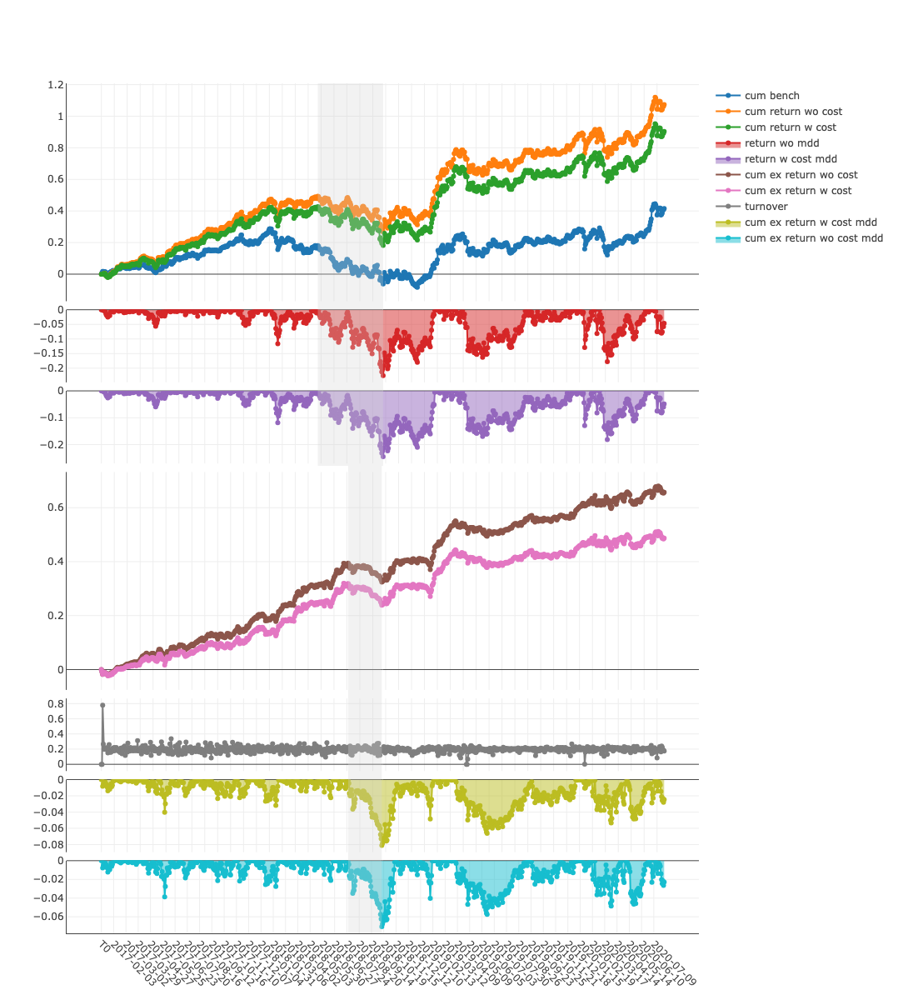

In [9]:
analysis_position.report_graph(report_normal_df)


### 📊 曲线解释

| 图例                          | 含义                                      |
| --------------------------- | --------------------------------------- |
| `cum bench`                 | **基准指数累积收益**，比如沪深 300 指数的总收益，用作策略对比。    |
| `cum return wo cost`        | **策略累积收益（未扣交易成本）**，策略每天收益累加形成的总收益曲线。    |
| `cum return w cost`         | **策略累积收益（扣交易成本）**，考虑手续费、滑点后的总收益。        |
| `return wo mdd`             | **策略单日收益（未扣最大回撤）**，每天的收益率，显示收益波动。       |
| `return w cost mdd`         | **策略单日收益（扣成本、考虑最大回撤）**，显示扣成本后的波动性。      |
| `cum ex return wo cost`     | **策略超额累积收益（未扣成本）** = 策略收益 − 基准收益累积。     |
| `cum ex return w cost`      | **策略超额累积收益（扣成本）**，考虑交易成本后的超额收益。         |
| `turnover`                  | **组合换手率**，每天买卖的资金占组合总资金比例，反映交易频率。       |
| `cum ex return w cost mdd`  | **策略超额累积收益最大回撤**，考虑成本的超额收益回撤曲线。         |
| `cum ex return wo cost mdd` | **策略超额累积收益最大回撤（未扣成本）**，展示超额收益在历史上的下行幅度。 |

---

### 🔹 总结

这张图主要用来分析：

1. **策略 vs 基准表现**

   * `cum return` 与 `cum bench` 对比，判断策略是否跑赢基准。
   * `cum ex return` 展示跑赢基准的累计超额收益。

2. **交易成本影响**

   * 对比 `wo cost` 和 `w cost` 曲线，了解手续费和滑点对策略的影响。

3. **风险指标**

   * `mdd` 曲线显示历史最大回撤，帮助评估风险。
   * `turnover` 曲线展示组合交易频率。




### risk analysis

/Users/huhao/src/qlib/qlib/contrib/report/analysis_position/risk_analysis.py:104: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/huhao/src/qlib/qlib/contrib/report/analysis_position/risk_analysis.py:104: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/huhao/src/qlib/qlib/contrib/report/analysis_position/risk_analysis.py:104: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

/Users/huhao/src/qlib/qlib/contrib/report/analysis_position/risk_analysis.py:104: FutureWarning:

When grouping with a length-1 list-like, you will need to p

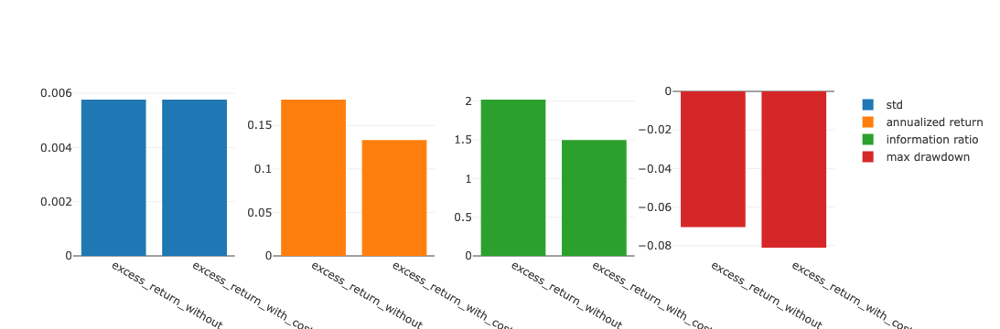

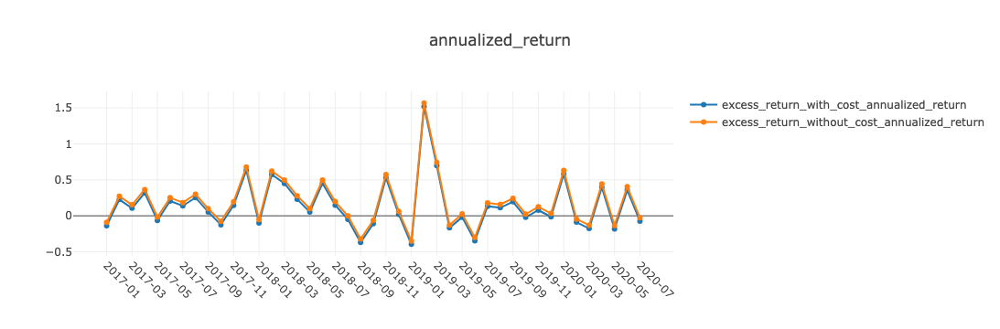

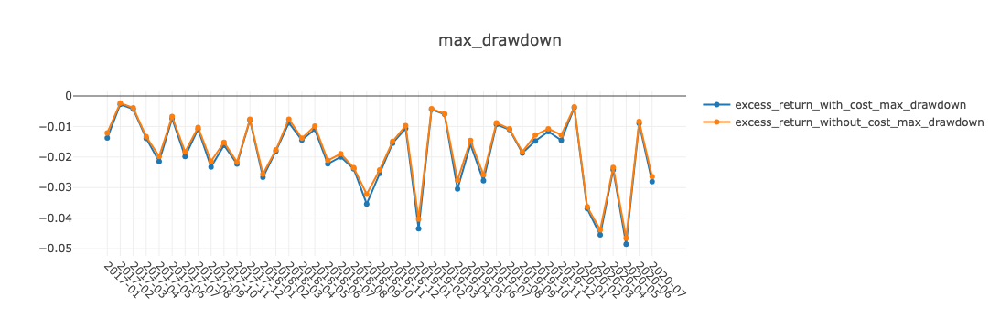

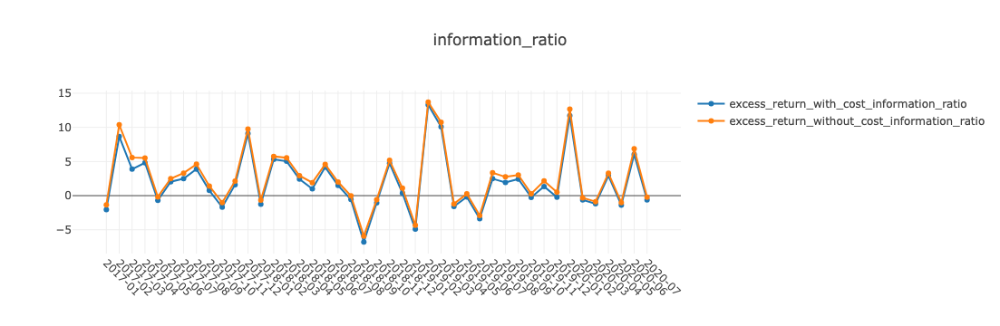

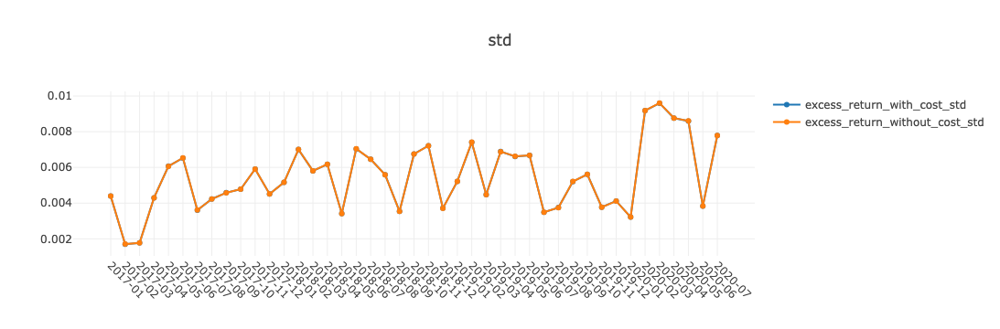

In [10]:
analysis_position.risk_analysis_graph(analysis_df, report_normal_df)

## analysis model

In [11]:
label_df = dataset.prepare("test", col_set="label")
label_df.columns = ["label"]

### score IC

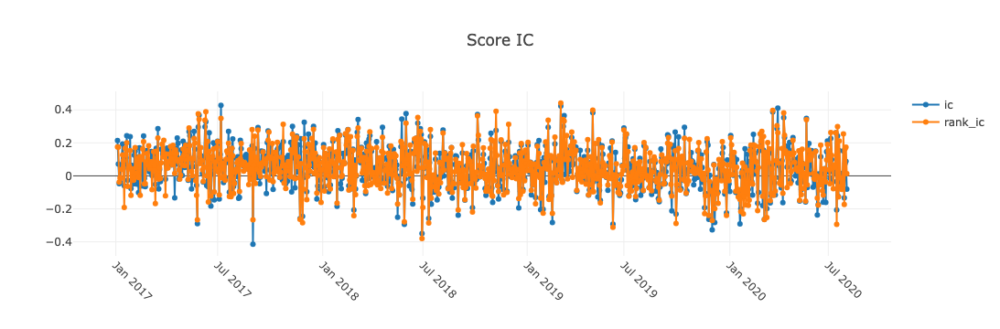

In [12]:
pred_label = pd.concat([label_df, pred_df], axis=1, sort=True).reindex(label_df.index)
analysis_position.score_ic_graph(pred_label)

### model performance

/Users/huhao/src/qlib/qlib/contrib/report/analysis_model/analysis_model_performance.py:157: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



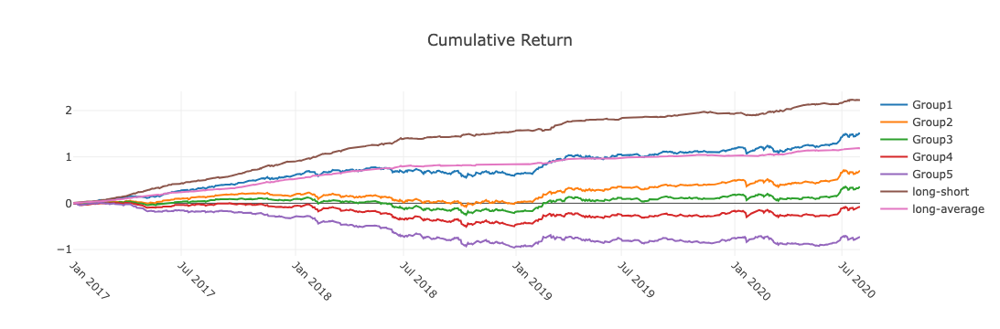

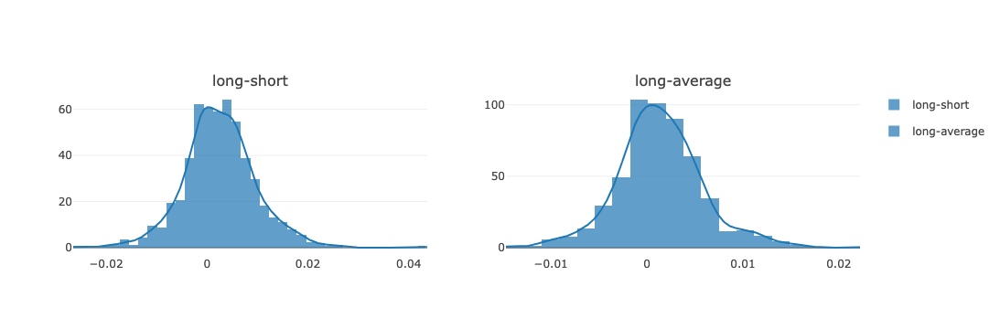

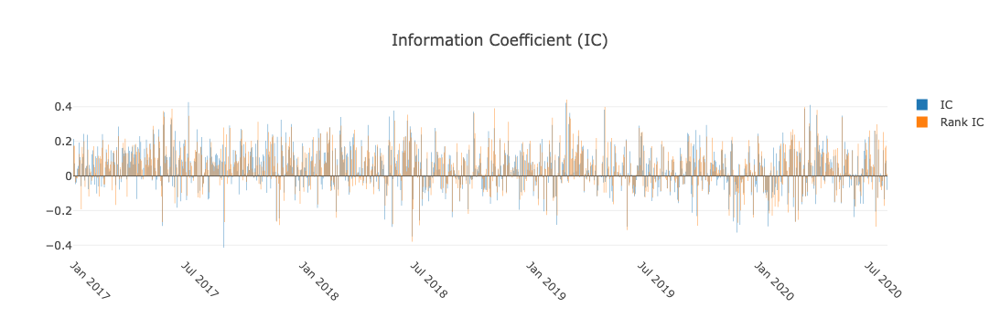

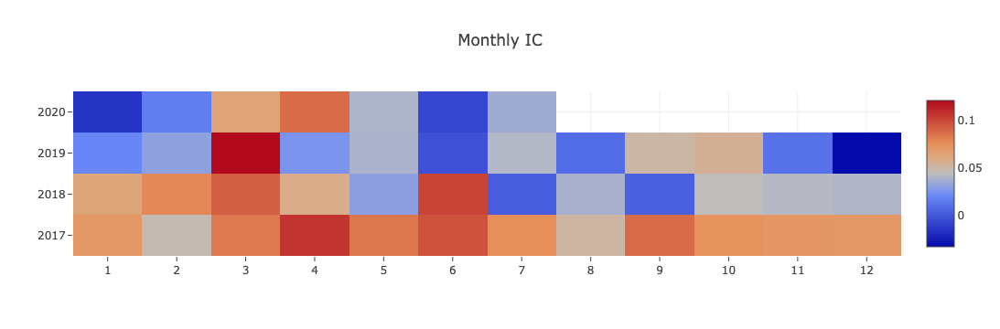

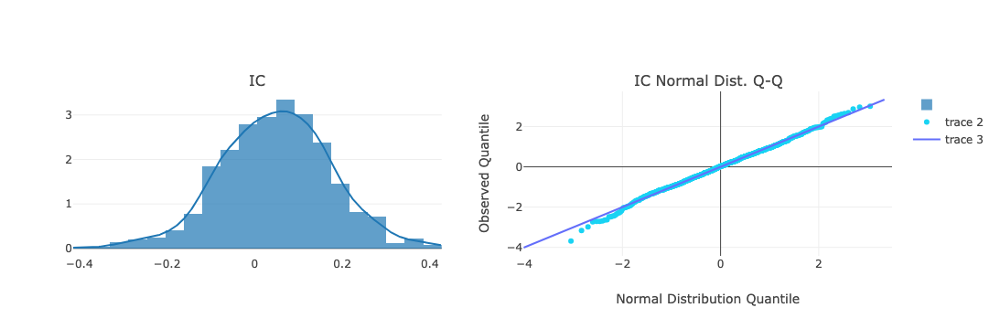

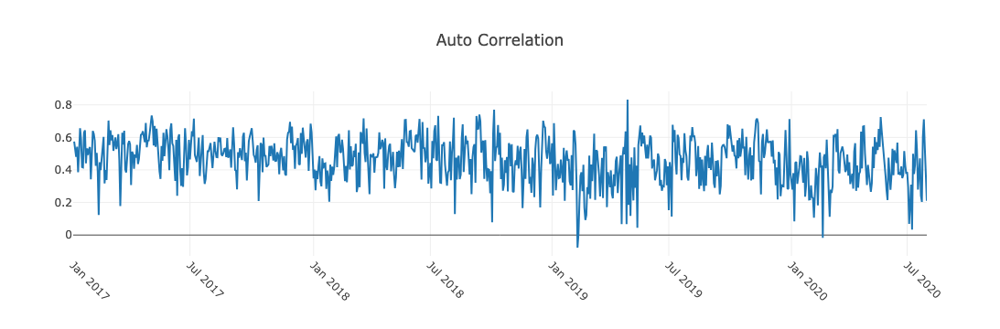

In [13]:
analysis_model.model_performance_graph(pred_label)